# To build a model for training and testing:

In [1]:
import os
import numpy as np # linear algebra
import matplotlib.pyplot as plt

In [2]:
# Dl framwork - tensorflow, keras a backend 
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Dense, Flatten, Dropout, BatchNormalization 
from tensorflow.keras.layers import Conv2D, SeparableConv2D, MaxPool2D, LeakyReLU, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from IPython.display import display
from os import listdir
from os.path import isfile, join
from PIL import Image
import glob
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
dir_name_train_Apple_Disease = 'dataset/Train/Apple Disease'
dir_name_train_Apple_healthy = 'dataset/Train/Apple healthy'
dir_name_train_Cherry_Disease = 'dataset/Train/Cherry Disease'
dir_name_train_Cherry_healthy = 'dataset/Train/Cherry healthy'
dir_name_train_Grape_Disease = 'dataset/Train/Grape Disease'
dir_name_train_Grape_healthy = 'dataset/Train/Grape healthy'
dir_name_train_Peach_Bacterial = 'dataset/Train/Peach Bacterial'
dir_name_train_Peach_healthy = 'dataset/Train/Peach healthy'
dir_name_train_Strawberry_Disease = 'dataset/Train/Strawberry Disease'
dir_name_train_Strawberry_healthy = 'dataset/Train/Strawberry healthy'

In [5]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(7, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()

In [6]:
def Images_details_Print_data(data, path):
    print(" ====== Images in: ", path)    
    for k, v in data.items():
        print("%s:\t%s" % (k, v))

def Images_details(path):
    files = [f for f in glob.glob(path + "**/*.*", recursive=True)]
    data = {}
    data['images_count'] = len(files)
    data['min_width'] = 10**100  # No image will be bigger than that
    data['max_width'] = 0
    data['min_height'] = 10**100  # No image will be bigger than that
    data['max_height'] = 0


    for f in files:
        im = Image.open(f)
        width, height = im.size
        data['min_width'] = min(width, data['min_width'])
        data['max_width'] = max(width, data['max_height'])
        data['min_height'] = min(height, data['min_height'])
        data['max_height'] = max(height, data['max_height'])

    Images_details_Print_data(data, path)


Trainned data for Apple Disease:

 ====== Images in:  dataset/Train/Apple Disease
images_count:	415
min_width:	256
max_width:	256
min_height:	256
max_height:	256



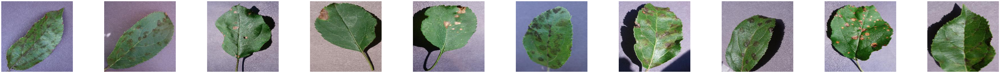

In [7]:
print("")
print("Trainned data for Apple Disease:")
print("")
Images_details(dir_name_train_Apple_Disease)
print("")
plot_images(dir_name_train_Apple_Disease, 10)


Trainned data for Apple healthy:

 ====== Images in:  dataset/Train/Apple healthy
images_count:	264
min_width:	256
max_width:	256
min_height:	256
max_height:	256



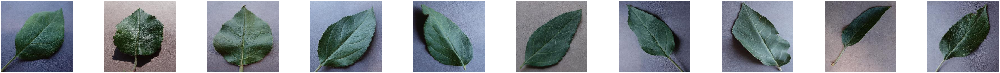

In [8]:
print("")
print("Trainned data for Apple healthy:")
print("")
Images_details(dir_name_train_Apple_healthy)
print("")
plot_images(dir_name_train_Apple_healthy, 10)


Trainned data for Cherry Disease:

 ====== Images in:  dataset/Train/Cherry Disease
images_count:	490
min_width:	256
max_width:	256
min_height:	256
max_height:	256



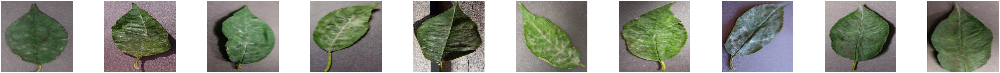

In [9]:
print("")
print("Trainned data for Cherry Disease:")
print("")
Images_details(dir_name_train_Cherry_Disease)
print("")
plot_images(dir_name_train_Cherry_Disease, 10)


Trainned data for Cherry healthy:

 ====== Images in:  dataset/Train/Cherry healthy
images_count:	542
min_width:	256
max_width:	256
min_height:	256
max_height:	256



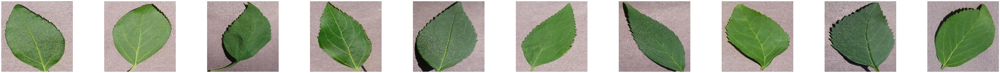

In [10]:
print("")
print("Trainned data for Cherry healthy:")
print("")
Images_details(dir_name_train_Cherry_healthy)
print("")
plot_images(dir_name_train_Cherry_healthy, 10)


Trainned data for Grape Disease:

 ====== Images in:  dataset/Train/Grape Disease
images_count:	454
min_width:	256
max_width:	256
min_height:	256
max_height:	256



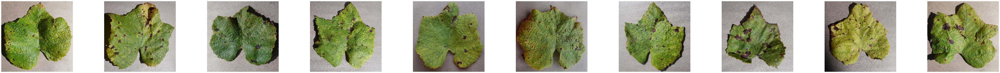

In [11]:
print("")
print("Trainned data for Grape Disease:")
print("")
Images_details(dir_name_train_Grape_Disease)
print("")
plot_images(dir_name_train_Grape_Disease, 10)


Trainned data for Grape healthy:

 ====== Images in:  dataset/Train/Grape healthy
images_count:	423
min_width:	256
max_width:	256
min_height:	256
max_height:	256



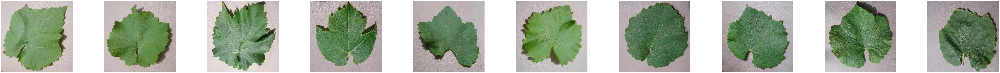

In [12]:
print("")
print("Trainned data for Grape healthy:")
print("")
Images_details(dir_name_train_Grape_healthy)
print("")
plot_images(dir_name_train_Grape_healthy, 10)


Trainned data for Peach Bacterial:

 ====== Images in:  dataset/Train/Peach Bacterial
images_count:	385
min_width:	256
max_width:	256
min_height:	256
max_height:	256



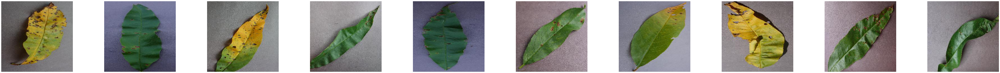

In [13]:
print("")
print("Trainned data for Peach Bacterial:")
print("")
Images_details(dir_name_train_Peach_Bacterial)
print("")
plot_images(dir_name_train_Peach_Bacterial, 10)


Trainned data for Peach healthy:

 ====== Images in:  dataset/Train/Peach healthy
images_count:	360
min_width:	256
max_width:	256
min_height:	256
max_height:	256



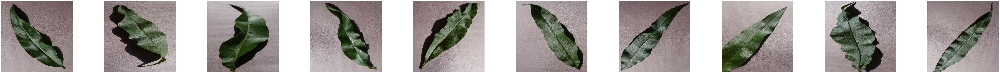

In [14]:
print("")
print("Trainned data for Peach healthy:")
print("")
Images_details(dir_name_train_Peach_healthy)
print("")
plot_images(dir_name_train_Peach_healthy, 10)


Trainned data for Strawberry Disease:

 ====== Images in:  dataset/Train/Strawberry Disease
images_count:	427
min_width:	256
max_width:	256
min_height:	256
max_height:	256



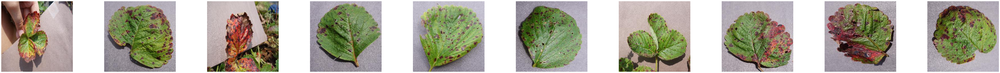

In [15]:
print("")
print("Trainned data for Strawberry Disease:")
print("")
Images_details(dir_name_train_Strawberry_Disease)
print("")
plot_images(dir_name_train_Strawberry_Disease, 10)


Trainned data for Strawberry healthy:

 ====== Images in:  dataset/Train/Strawberry healthy
images_count:	456
min_width:	256
max_width:	256
min_height:	256
max_height:	256



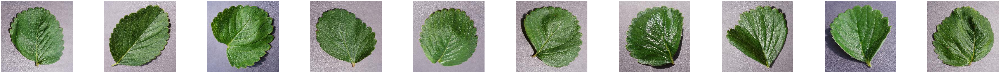

In [16]:
print("")
print("Trainned data for Strawberry healthy:")
print("")
Images_details(dir_name_train_Strawberry_healthy)
print("")
plot_images(dir_name_train_Strawberry_healthy, 10)

In [17]:
Classifier=Sequential()
Classifier.add(Convolution2D(32,(3,3),input_shape=(128,128,3),activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(2,2)))
Classifier.add(Flatten())
Classifier.add(Dense(38, activation='relu'))

In [18]:
Classifier.add(Dense(10, activation='softmax'))
Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [19]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)
test_datagen=ImageDataGenerator(rescale=1./255)

In [20]:
training_set=train_datagen.flow_from_directory('dataset/Train',target_size=(128,128),batch_size=32,class_mode='categorical')
test_set=test_datagen.flow_from_directory('dataset/Test',target_size=(128,128),batch_size=32,class_mode='categorical')

Found 4216 images belonging to 10 classes.
Found 909 images belonging to 10 classes.


In [21]:
epochs = 20
batch_size = 32

In [22]:
#### Fitting the model
history = Classifier.fit_generator(
           training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size)

Epoch 1/20
131/131 [==============================] - 58s 432ms/step - loss: 2.8647 - accuracy: 0.1228 - val_loss: 2.3013 - val_accuracy: 0.2132
Epoch 2/20
131/131 [==============================] - 48s 363ms/step - loss: 2.2960 - accuracy: 0.1286 - val_loss: 2.3006 - val_accuracy: 0.2121
Epoch 3/20
131/131 [==============================] - 43s 331ms/step - loss: 2.2929 - accuracy: 0.1288 - val_loss: 2.3011 - val_accuracy: 0.2109
Epoch 4/20
131/131 [==============================] - 43s 327ms/step - loss: 2.1125 - accuracy: 0.2278 - val_loss: 1.3288 - val_accuracy: 0.5502
Epoch 5/20
131/131 [==============================] - 44s 335ms/step - loss: 1.2251 - accuracy: 0.5719 - val_loss: 0.5629 - val_accuracy: 0.8460
Epoch 6/20
131/131 [==============================] - 43s 327ms/step - loss: 0.8675 - accuracy: 0.7058 - val_loss: 0.6293 - val_accuracy: 0.8069
Epoch 7/20
131/131 [==============================] - 44s 333ms/step - loss: 0.7352 - accuracy: 0.7522 - val_loss: 0.4182 - val_ac

In [23]:
def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

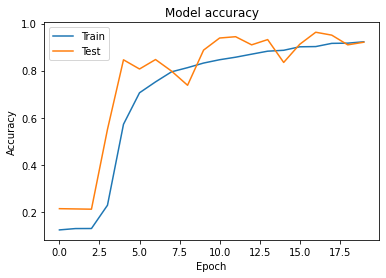

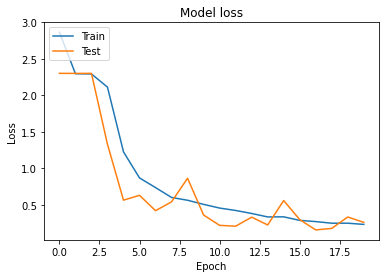

In [24]:
graph()